# 공간분석과 공간통계: GIS 버퍼분석 & 중첩분석 - Part 1 (basics of geopandas & folium)
#### 가천대학교 공간정보시스템(14842001) 장요한 (ycanns@gachon.ac.kr)

---



#### 1. Initialization

In [52]:
import sys
!{sys.executable} -m pip install geopandas
!{sys.executable} -m pip install cartoframes
# ! pip install geopandas
# ! pip install cartoframes

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [53]:
import pandas as pd
import geopandas as gpd
from cartoframes.viz import Layer, color_category_style
from shapely.geometry import Polygon, Point, LineString
from shapely.ops import transform
from functools import partial
import pyproj
import numpy as np, matplotlib.pyplot as plt
plt.style.use('ggplot')
import folium
from folium.plugins import FloatImage





import os

#### 2. Import DATA

In [ ]:
# 필요한 파일 업로드 기능 (구글 코랩)
from google.colab import files
uploaded = files.upload()
data_folder = os. getcwd()

Saving LARD_ADM_SECT_SGG_11.dbf to LARD_ADM_SECT_SGG_11.dbf
Saving LARD_ADM_SECT_SGG_11.prj to LARD_ADM_SECT_SGG_11.prj
Saving LARD_ADM_SECT_SGG_11.shp to LARD_ADM_SECT_SGG_11.shp
Saving LARD_ADM_SECT_SGG_11.shx to LARD_ADM_SECT_SGG_11.shx


In [54]:
# 구글 드리이브에 파일이 있는 경우
data_folder = "/content/drive/MyDrive/sample_files/"

In [55]:
data_folder

'/content/drive/MyDrive/sample_files/'

In [56]:
# 시군구(SGG) 와 읍면동(UMD) GIS 파일 읽어오기
Seoul_SGG = gpd.read_file(data_folder  + "LARD_ADM_SECT_SGG_서울/LARD_ADM_SECT_SGG_11.shp", encoding='cp949')
Seoul_UMD = gpd.read_file(data_folder  + "LSMD_ADM_SECT_UMD_서울/LSMD_ADM_SECT_UMD_11.shp", encoding='cp949')

Kyggi_SGG = gpd.read_file(data_folder  + "LARD_ADM_SECT_SGG_경기/LARD_ADM_SECT_SGG_41.shp", encoding='cp949')
Kyggi_UMD = gpd.read_file(data_folder  + "LSMD_ADM_SECT_UMD_경기/LSMD_ADM_SECT_UMD_41.shp", encoding='cp949')


In [57]:
print(Seoul_SGG)

   ADM_SECT_C SGG_NM  SGG_OID COL_ADM_SE  GID  \
0       11740    강동구      NaN      11740  125   
1       11710    송파구      NaN      11710  126   
2       11680    강남구      NaN      11680  127   
3       11650    서초구      NaN      11650  128   
4       11620    관악구      NaN      11620  129   
5       11590    동작구      NaN      11590  130   
6       11560   영등포구      NaN      11560  131   
7       11545    금천구      NaN      11545  132   
8       11530    구로구      NaN      11530  133   
9       11500    강서구      NaN      11500  134   
10      11470    양천구      NaN      11470  135   
11      11440    마포구      NaN      11440  136   
12      11410   서대문구      NaN      11410  137   
13      11380    은평구      NaN      11380  138   
14      11350    노원구      NaN      11350  139   
15      11320    도봉구      NaN      11320  140   
16      11305    강북구      NaN      11305  141   
17      11290    성북구      NaN      11290  142   
18      11260    중랑구      NaN      11260  143   
19      11230   동대문구

In [58]:
print(Seoul_UMD)

       EMD_CD EMD_NM  SGG_OID COL_ADM_SE   GID  \
0    11110154    장사동     4315      11110  3037   
1    11110153    돈의동     4314      11110  3038   
2    11290134    길음동     4532      11290  2820   
3    11290133    정릉동     4531      11290  2821   
4    11290132  보문동3가     4530      11290  2822   
..        ...    ...      ...        ...   ...   
462  11680110   압구정동     1049      11680  2652   
463  11680108    논현동     1183      11680  2653   
464  11680107    신사동     1050      11680  2654   
465  11680106    대치동     1215      11680  2655   
466  11680105    삼성동     1184      11680  2656   

                                              geometry  
0    POLYGON ((955438.037 1952426.894, 955438.325 1...  
1    POLYGON ((955054.604 1952786.670, 955055.964 1...  
2    POLYGON ((957364.694 1957374.485, 957376.240 1...  
3    POLYGON ((957598.059 1956308.659, 957583.162 1...  
4    POLYGON ((957323.502 1954285.821, 957323.592 1...  
..                                                 ...  


In [59]:
print(Kyggi_SGG)

   ADM_SECT_C   SGG_NM  SGG_OID COL_ADM_SE  GID  \
0       41670      여주시      1.0      41670  255   
1       41830      양평군      NaN      41830  202   
2       41820      가평군      NaN      41820  203   
3       41800      연천군      NaN      41800  204   
4       41670      여주시      NaN      41670  205   
5       41650      포천시      NaN      41650  206   
6       41630      양주시      NaN      41630  207   
7       41610      광주시      NaN      41610  208   
8       41590      화성시      NaN      41590  209   
9       41570      김포시      NaN      41570  210   
10      41550      안성시      NaN      41550  211   
11      41500      이천시      NaN      41500  212   
12      41480      파주시      NaN      41480  213   
13      41465   용인시수지구      NaN      41460  214   
14      41463   용인시기흥구      NaN      41460  215   
15      41461   용인시처인구      NaN      41460  216   
16      41450      하남시      NaN      41450  217   
17      41430      의왕시      NaN      41430  218   
18      41410      군포시      NaN

In [60]:
print(Kyggi_UMD)

       EMD_CD EMD_NM  SGG_OID COL_ADM_SE   GID  \
0    41190123    삼정동     3954      41190  5180   
1    41190124     내동     3955      41190  5181   
2    41190115    옥길동     3956      41190  5182   
3    41570107    풍무동     3626      41570  5137   
4    41630250    백석읍     3156      41630  5138   
..        ...    ...      ...        ...   ...   
768  41570109    구래동     2868      41570  4332   
769  41570108    마산동     2867      41570  4333   
770  41570106    사우동     2865      41570  4335   
771  41570105    감정동     2864      41570  4336   
772  41570104    장기동     2863      41570  4337   

                                              geometry  
0    POLYGON ((935886.449 1946412.474, 935883.109 1...  
1    POLYGON ((935886.449 1946412.474, 935879.700 1...  
2    POLYGON ((938741.219 1940538.468, 938746.599 1...  
3    POLYGON ((929738.402 1956431.399, 929774.674 1...  
4    POLYGON ((949620.351 1973195.655, 949766.405 1...  
..                                                 ...  


In [61]:
Seoul_SGG.head()

,ADM_SECT_C,SGG_NM,SGG_OID,COL_ADM_SE,GID,geometry
0,11740,강동구,NaN,11740,125,"POLYGON ((971595.075 1952405.815, 971596.036 1..."
1,11710,송파구,NaN,11710,126,"POLYGON ((965821.957 1949386.153, 965816.737 1..."
2,11680,강남구,NaN,11680,127,"POLYGON ((959331.597 1948602.068, 959342.021 1..."
3,11650,서초구,NaN,11650,128,"POLYGON ((956982.039 1947144.037, 956982.518 1..."
4,11620,관악구,NaN,11620,129,"POLYGON ((949438.997 1944127.713, 949456.647 1..."


In [62]:
Seoul_UMD.head()

,EMD_CD,EMD_NM,SGG_OID,COL_ADM_SE,GID,geometry
0,11110154,장사동,4315,11110,3037,"POLYGON ((955438.037 1952426.894, 955438.325 1..."
1,11110153,돈의동,4314,11110,3038,"POLYGON ((955054.604 1952786.670, 955055.964 1..."
2,11290134,길음동,4532,11290,2820,"POLYGON ((957364.694 1957374.485, 957376.240 1..."
3,11290133,정릉동,4531,11290,2821,"POLYGON ((957598.059 1956308.659, 957583.162 1..."
4,11290132,보문동3가,4530,11290,2822,"POLYGON ((957323.502 1954285.821, 957323.592 1..."


In [63]:
Kyggi_SGG.head()

,ADM_SECT_C,SGG_NM,SGG_OID,COL_ADM_SE,GID,geometry
0,41670,여주시,1.0,41670,255,"POLYGON ((1197798.732 2017143.238, 1197805.333..."
1,41830,양평군,NaN,41830,202,"POLYGON ((982850.492 1946970.632, 982851.709 1..."
2,41820,가평군,NaN,41820,203,"POLYGON ((995776.586 2003840.576, 995850.072 2..."
3,41800,연천군,NaN,41800,204,"MULTIPOLYGON (((969139.245 2026871.151, 969278..."
4,41670,여주시,NaN,41670,205,"POLYGON ((1001702.361 1937472.187, 1001797.089..."


In [ ]:
Kyggi_UMD.head()

,EMD_CD,EMD_NM,SGG_OID,COL_ADM_SE,GID,geometry
0,41190123,삼정동,3954,41190,5180,"POLYGON ((935886.449 1946412.474, 935883.109 1..."
1,41190124,내동,3955,41190,5181,"POLYGON ((935886.449 1946412.474, 935879.700 1..."
2,41190115,옥길동,3956,41190,5182,"POLYGON ((938741.219 1940538.468, 938746.599 1..."
3,41570107,풍무동,3626,41570,5137,"POLYGON ((929738.402 1956431.399, 929774.674 1..."
4,41630250,백석읍,3156,41630,5138,"POLYGON ((949620.351 1973195.655, 949766.405 1..."


#### 3. Visualizing DATA

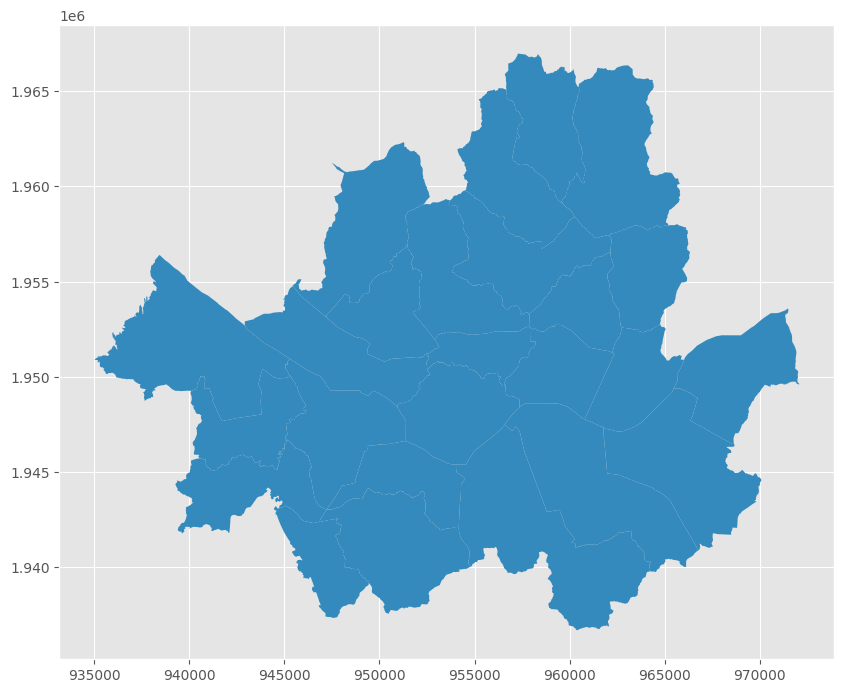

In [64]:
# GIS 데이터 Quick Checking: 서울 시군구 파일
plt.rcParams['figure.figsize']=(10,20)
Seoul_SGG.plot()
plt.show()

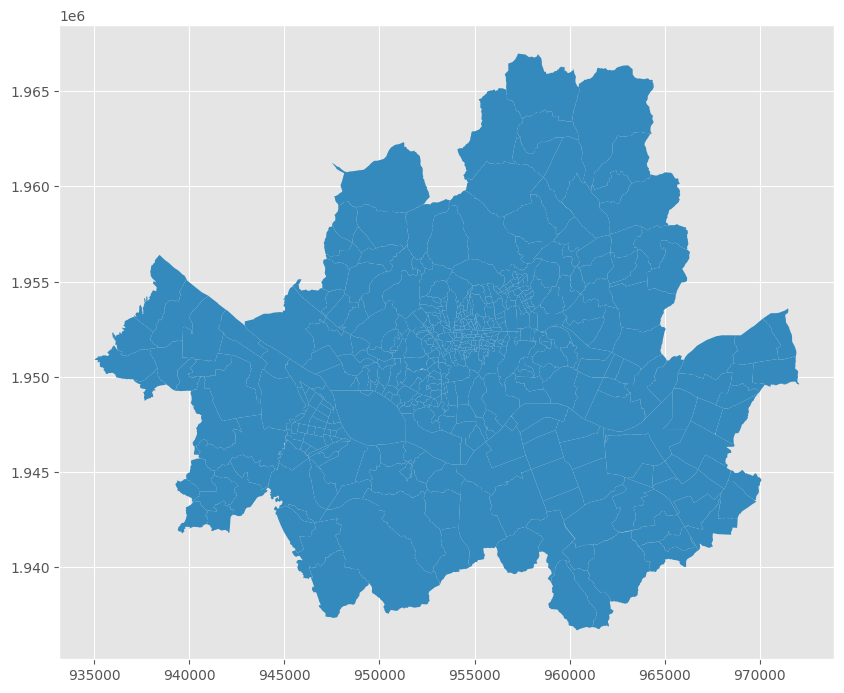

In [65]:
# GIS 데이터 Quick Checking: 서울 읍면동 파일
plt.rcParams['figure.figsize']=(10,20)
Seoul_UMD.plot()
plt.show()

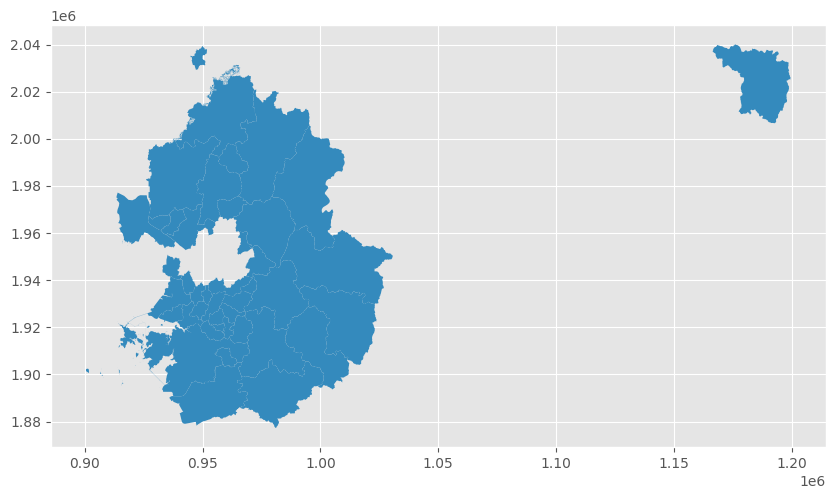

In [66]:
# GIS 데이터 Quick Checking: 경기 시군구 파일
plt.rcParams['figure.figsize']=(10,20)
Kyggi_SGG.plot()
plt.show()

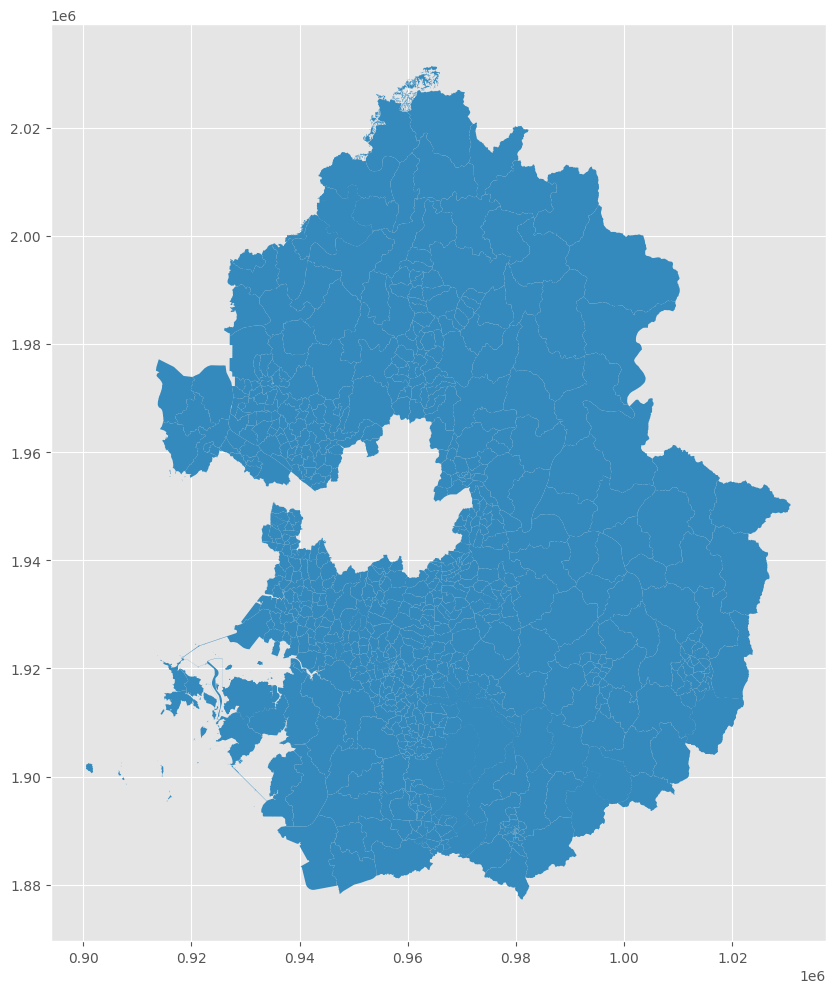

In [67]:
# GIS 데이터 Quick Checking: 경기 읍면동 파일
plt.rcParams['figure.figsize']=(10,20)
Kyggi_UMD.plot()
plt.show()

In [68]:
Kyggi_SGG['SGG_NM'].unique()

array(['여주시', '양평군', '가평군', '연천군', '포천시', '양주시', '광주시', '화성시', '김포시',
       '안성시', '이천시', '파주시', '용인시수지구', '용인시기흥구', '용인시처인구', '하남시', '의왕시',
       '군포시', '시흥시', '오산시', '남양주시', '구리시', '과천시', '고양시일산서구', '고양시일산동구',
       '고양시덕양구', '안산시단원구', '안산시상록구', '동두천시', '평택시', '광명시', '부천시',
       '안양시동안구', '안양시만안구', '의정부시', '성남시 분당구', '성남시 중원구', '성남시 수정구',
       '수원시 영통구', '수원시 팔달구', '수원시 권선구', '수원시 장안구'], dtype=object)

In [69]:
Kyggi_SGG[Kyggi_SGG['SGG_NM']=='성남시 분당구']

,ADM_SECT_C,SGG_NM,SGG_OID,COL_ADM_SE,GID,geometry
36,41135,성남시 분당구,NaN,41130,237,"POLYGON ((962459.288 1933176.518, 962459.447 1..."


In [70]:
Kyggi_SGG[(Kyggi_SGG['SGG_NM']=='성남시 분당구') | (Kyggi_SGG['SGG_NM']=='성남시 중원구') | (Kyggi_SGG['SGG_NM']=='성남시 수정구')]


,ADM_SECT_C,SGG_NM,SGG_OID,COL_ADM_SE,GID,geometry
36,41135,성남시 분당구,NaN,41130,237,"POLYGON ((962459.288 1933176.518, 962459.447 1..."
37,41133,성남시 중원구,NaN,41130,238,"POLYGON ((971787.037 1941627.348, 971794.930 1..."
38,41131,성남시 수정구,NaN,41130,239,"POLYGON ((968165.515 1941710.496, 968177.333 1..."


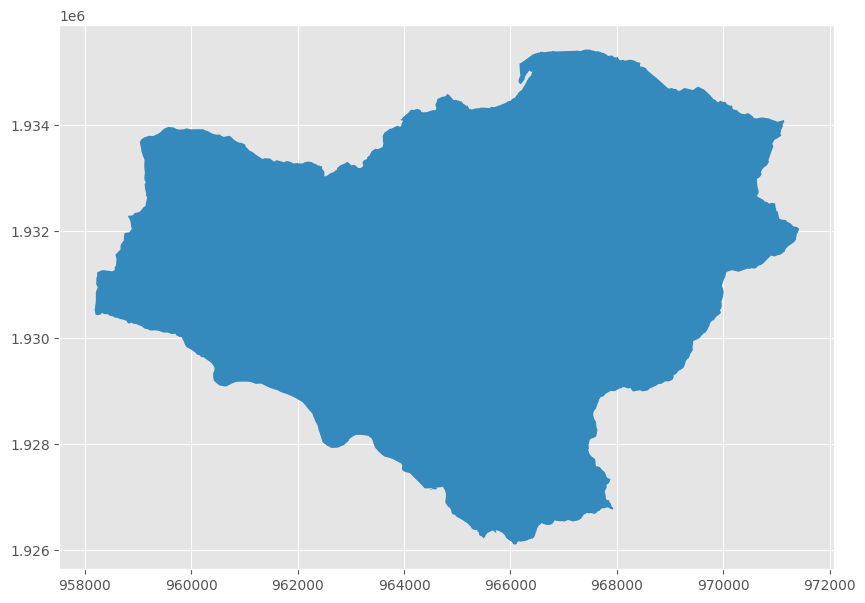

In [71]:
# GIS 데이터 Quick Checking: 경기 읍면동 파일
plt.rcParams['figure.figsize']=(10,20)
Kyggi_SGG[Kyggi_SGG['SGG_NM']=='성남시 분당구'].plot()
plt.show()

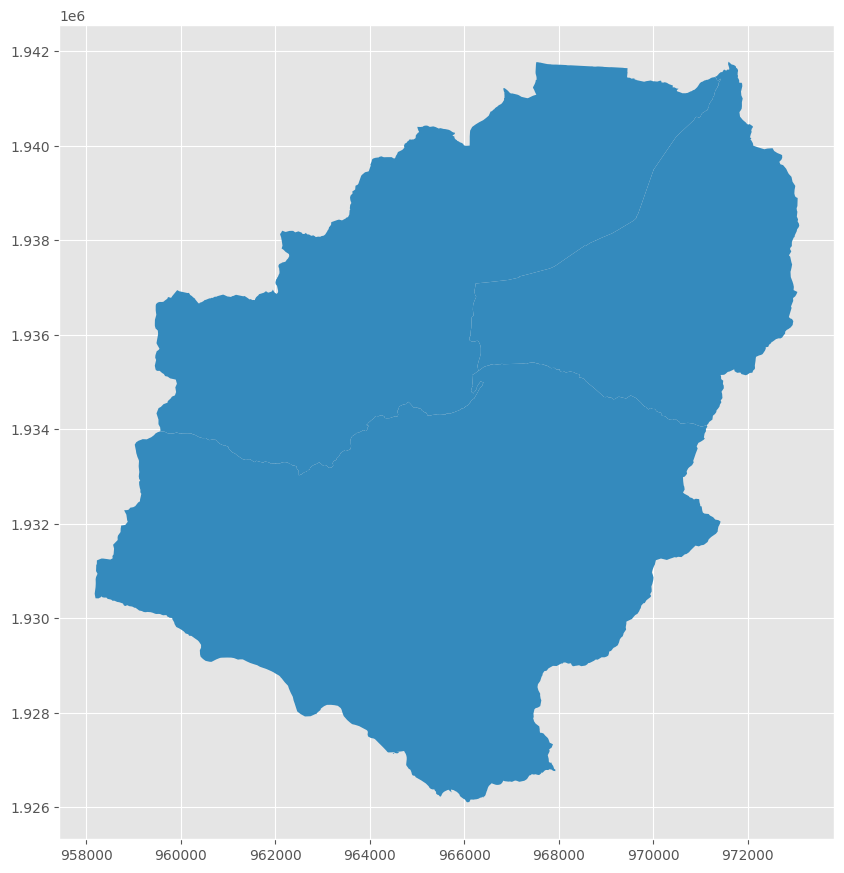

In [72]:
# GIS 데이터 Quick Checking: 경기 읍면동 파일
plt.rcParams['figure.figsize']=(10,20)
Kyggi_SGG[(Kyggi_SGG['SGG_NM']=='성남시 분당구') | (Kyggi_SGG['SGG_NM']=='성남시 중원구') | (Kyggi_SGG['SGG_NM']=='성남시 수정구')].plot()
plt.show()

In [73]:

map = folium.Map(location=[37.45531, 127.13410], zoom_start=10, tiles='OpenStreet Map', control_scale = True)
folium.GeoJson(data=Seoul_SGG["geometry"], name='서울 시군구').add_to(map)
#folium.GeoJson(data=Seoul_UMD["geometry"], name='서울 읍면동').add_to(map)
folium.GeoJson(data=Kyggi_SGG["geometry"], name='경기 시군구').add_to(map)
#folium.GeoJson(data=Kyggi_UMD["geometry"], name='경기 읍면동').add_to(map)

# add a legend diagram to map
compass_rose = folium.FeatureGroup('compass rose')
FloatImage('https://upload.wikimedia.org/wikipedia/commons/9/99/Compass_rose_simple.svg', bottom =80, left = 7).add_to(compass_rose)
compass_rose.add_to(map)

# later control
folium.LayerControl(collapsed=False).add_to(map)

map

In [74]:
# 관심 위/경도 좌표 설정
# 위도
latitude = 37.45531
# 경도
longitude = 127.13410


folium.Marker([latitude, longitude],
              popup=[latitude, longitude],
              tooltip="가천대학교 AI관").add_to(map)
map

In [75]:
# 단순 버퍼 표시하기 (실측 거리 X)
folium.CircleMarker([latitude, longitude],
                    color='tomato',
                    radius = 100, 
              tooltip="가천대학교 AI관").add_to(map)
map

In [76]:
!pip install mapclassify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [87]:
import geopandas as gpd
import numpy as np
import shapely.geometry
import folium


target_SGG = Kyggi_SGG[(Kyggi_SGG['SGG_NM']=='성남시 분당구') | (Kyggi_SGG['SGG_NM']=='성남시 중원구') | (Kyggi_SGG['SGG_NM']=='성남시 수정구')]
buffer_Size_in_km = 8

# select a point randomly from total bounds of geometry
buffer_df = gpd.GeoDataFrame(
    geometry=[
        shapely.geometry.Point(
            np.random.uniform(*target_SGG.total_bounds[[0, 2]], size=1)[0],
            np.random.uniform(*target_SGG.total_bounds[[1, 3]], size=1)[0],
        )
    ],
    crs=target_SGG.crs,
)

buffer_df = gpd.GeoDataFrame(
    geometry=buffer_df.to_crs(buffer_df.estimate_utm_crs())
    .buffer(8 * 10**3)
    .to_crs(buffer_df.crs)
)


# need overlay not sjoin
intersection_MeshBlock = gpd.overlay(buffer_df, target_SGG, how="intersection")

m = target_SGG.explore(name="base", style_kwds={"fill":False})
m = buffer_df.explore(m=m, name="buffer", style_kwds={"fill":False})
m = intersection_MeshBlock.explore(m=m, name="intersection", style_kwds={"fillColor":"orange"})
folium.LayerControl().add_to(m)

m

In [89]:
m = folium.Map((latitude, longitude), max_zoom=20, zoom_start=16)
folium.Marker((latitude, longitude), popup='가천대학교 AI관').add_to(m)
m

In [96]:
#target_point = gpd.GeoDataFrame(geometry=[longitude, latitude])

buffer_Size_in_km = 8
buffer_distance_m = buffer_Size_in_km * 1000

def circle(lon, lat, buffer_m):
    radius = buffer_distance_m
    local_azimuthal_projection = "+proj=aeqd +R=6378000 +units=m +lat_0={} +lon_0={}".format(lat, lon)
    wgs84_to_aeqd = partial(pyproj.transform, pyproj.Proj("+proj=longlat +datum=WGS84 +no_defs"), pyproj.Proj(local_azimuthal_projection))
    aeqd_to_wgs84 = partial(pyproj.transform, pyproj.Proj(local_azimuthal_projection), pyproj.Proj("+proj=longlat +datum=WGS84 +no_defs"))

    center = Point(float(lon), float(lat))
    point_transformed = transform(wgs84_to_aeqd, center)
    buffer = point_transformed.buffer(radius/1.4, resolution=64)
    circle_poly = transform(aeqd_to_wgs84, buffer)
    elevation=LineString(list(circle_poly.exterior.coords))
    return elevation

elevation = circle(longitude, latitude, buffer_distance_m)
test = pd.DataFrame({'geometry':[elevation]})
test =gpd.GeoDataFrame(test , geometry='geometry', crs="EPSG:4326")

m = folium.Map([latitude, longitude], control_scale=True)
tooltip=folium.GeoJson(test , name='circle').add_to(m)
folium.LayerControl().add_to(m)
m

/usr/local/lib/python3.10/dist-packages/shapely/ops.py:274: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  return type(geom)(zip(*func(*zip(*geom.coords))))
/usr/local/lib/python3.10/dist-packages/shapely/ops.py:276: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  shell = type(geom.exterior)(zip(*func(*zip(*geom.exterior.coords))))


In [81]:
# define the target point
target_point = shapely.geometry.Point(longitude, latitude)

# calculate 8km buffer around the target point
buffer_Size_in_km = 8
buffer_distance_m = buffer_Size_in_km / 1000
buffer_polygon = target_point.buffer(buffer_distance_m)

# convert buffer polygon to a GeoDataFrame
buffer_df = gpd.GeoDataFrame(geometry=[buffer_polygon], crs=target_SGG.crs)

# find intersection between buffer and target geometry
intersection = gpd.overlay(buffer_df, target_SGG, how="intersection")

# create folium map centered on target point
map_center = [latitude, longitude]
m = folium.Map(location=map_center, zoom_start=12, control_scale = True)

# add target geometry to map
folium.GeoJson(target_SGG).add_to(m)

# add buffer polygon to map
folium.GeoJson(buffer_polygon).add_to(m)

# add intersection to map
folium.GeoJson(intersection).add_to(m)

# add layer control to map
folium.LayerControl().add_to(m)

# show map
m

## END CODE
---------------